# Модуль 1

### 1.1 Парсинг данных

In [6]:
#Импортирование необходимых библиотек
import pandas as pd
import numpy as np
from pprint import pprint
import matplotlib.pyplot as plt
import seaborn as sns

import codecs
import json
import glob
pd.set_option('display.max_columns', None)
from pandas import json_normalize

**Импорт статей**

In [7]:
#Получаю путь к файлам json из папки, используя модуль glob
path = 'data'
file = glob.glob(path + "/*.json")
df_full=pd.DataFrame()


# Использую цикл для получения файла и его загрузки, с помощью json.load 
for filename in file:
    name = filename.split("\\")[-1][:-5]
    with codecs.open(filename, 'r', 'utf-8-sig') as json_file:  
        data = json.load(json_file)
        
# Использую цикл для получения файла и его загрузки, с помощью json.load     
    for article in data['refs']:  
        if article != None:
            df=pd.concat(
                [
                    pd.DataFrame([article[0]],columns=['Post']),
                    json_normalize(article[1]),
                    pd.DataFrame([name],columns=['Company'])
                ],
                axis=1
            )
            df_full=pd.concat([df_full,df],axis=0,ignore_index=True)

JSONDecodeError: ignored

In [8]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693 entries, 0 to 692
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Post     693 non-null    object
 1   day      693 non-null    object
 2   month    693 non-null    object
 3   time     693 non-null    object
 4   Company  693 non-null    object
dtypes: object(5)
memory usage: 27.2+ KB


In [9]:
df_full.head()

,Post,day,month,time,Company
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,data/Vinci Agency
1,"Это — подкаст о контент-маркетинге и о тех, кт...",5,октября,11:23,data/Vinci Agency
2,"Привет, Хабр! Меня зовут Алсу Хлуднева, я — уп...",2,сентября,17:34,data/Vinci Agency
3,Алексей Скорик из Vinci Agency специально для ...,4,марта,18:39,data/Vinci Agency
4,This post is a continuation of the first part ...,21,января,14:54,data/Vinci Agency


Датафрейм с информацией о компании

In [11]:
#Путь к файлам .geojson
path = 'data'
file = glob.glob(path + "/*.json")


df = pd.DataFrame(columns=['rate','subs','industries','about','Company']) 

#Цикл для получения файла и его загрузки, используя json.load 
for filename in file:
    with codecs.open(filename, 'r', 'utf-8-sig') as json_file:  
        data = json.load(json_file)
        name = filename.split("\\")[-1][:-5]   
        try:
            company_info=pd.concat([json_normalize(data['info']),pd.DataFrame([name],columns=['Company'])],axis=1)
        except:
            d={'rate':['Не указано'],'subs':['Не указано'],'industries':['Не указано'],'about':['Не указано']}
            company_info=pd.concat([pd.DataFrame(d),pd.DataFrame([name],columns=['Company'])],axis=1)
    df = pd.concat([df,company_info], axis=0, ignore_index=True)
df.head()    
   

,rate,subs,industries,about,Company
0,Не указано,Не указано,Не указано,Не указано,data/Vinci Agency
1,Не указано,Не указано,Не указано,Не указано,data/Студия Артемия Лебедева
2,Не указано,Не указано,Не указано,Не указано,data/Федерация креативных индустрий
3,113.82,71000,"[Веб-разработка, Дизайн и юзабилити, Реклама и...",Образовательная платформа Skillbox — один из л...,data/skillbox
4,Не указано,Не указано,Не указано,Не указано,data/Гэллэри Сервис


In [12]:
tk = df_full.merge(df, on='Company',how='left')

In [13]:
tk.shape

(693, 9)

In [14]:
tk.head(200)

,Post,day,month,time,Company,rate,subs,industries,about
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано
1,"Это — подкаст о контент-маркетинге и о тех, кт...",5,октября,11:23,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано
2,"Привет, Хабр! Меня зовут Алсу Хлуднева, я — уп...",2,сентября,17:34,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано
3,Алексей Скорик из Vinci Agency специально для ...,4,марта,18:39,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано
4,This post is a continuation of the first part ...,21,января,14:54,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано
...,...,...,...,...,...,...,...,...,...
195,"Рома Воронежский, один из сотрудников Студии А...",6,февраля,01:08,data/Студия Артемия Лебедева,Не указано,Не указано,Не указано,Не указано
196,На сайте газеты «Московский Комсомолец» запуст...,28,декабря,18:55,data/Студия Артемия Лебедева,Не указано,Не указано,Не указано,Не указано
197,"Как оказалось, владелец компании «Русский стан...",15,декабря,09:05,data/Студия Артемия Лебедева,Не указано,Не указано,Не указано,Не указано
198,"На днях, обрел своего нового владельца домен V...",10,декабря,12:54,data/Студия Артемия Лебедева,Не указано,Не указано,Не указано,Не указано


В нашу выборку были включены все обязательные атрибуты: 
* Post    - тест статьи, потому что...
* Company  
* Дата время
...

Вывод: построен исходныый набор данных, в набор включены все необходимые данные. 

Набор был преобразован в требуемый формат. Добавление дополнительных атрибутов не требуется

### 1.2 Формирование структуры набора данных

На номинацию влияет ....

### 1.3 Предварительная обработка данных  

In [16]:
!pip install pandas
!pip install pymorphy2
!pip install nltk


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.5/55.5 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 48.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for docopt: filename=docopt-0.6.2-py2.py3-none-any.whl size=13707 sha256=6d1712552a8016244f5172d6a639b8e130e8cbfa7bc8de48964c98f7186925b0
  Stored in directory: /root/.cache/pip/wheels/fc/ab/d4/5da2067ac95b36618c629a5f93f809425700506f72c9732fac
Successfully built docopt
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


NameError: ignored

In [17]:
import pymorphy2
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [18]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [19]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
tk.dropna(inplace=True)
tk.reset_index(drop=True, inplace=True)

Напишу функцию отчистки текста, которая:
* приведет слова в один регистр,
* удалит все лишние символы, кроме букв и символа пробела,
* проведет токенизацию по словам,
* соберет все полученные токены в массив, привидя их в нормальные формы
* соберет все токены, которые не являются стоп словами.


In [20]:
sw = stopwords.words('russian')
morph = pymorphy2.MorphAnalyzer()

def clear_text(text):
    text=text.lower()
    text = re.sub(r'[^а-яё ]','', str(text))
    tokens=word_tokenize(text, language="russian")
    tokens = [morph.parse(i)[0].normal_form for i in tokens]
    tokens = [i for i in tokens if i not in sw and len(i) > 3]
    return tokens

Применю написанную функцию на нашем датафрейме.

In [21]:
tk['lemmatize_tokens'] = tk['Post'].apply(clear_text)

In [22]:
tk.head()

,Post,day,month,time,Company,rate,subs,industries,about,lemmatize_tokens
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ..."
1,"Это — подкаст о контент-маркетинге и о тех, кт...",5,октября,11:23,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[подкаст, контентмаркетинг, писать, редактиров..."
2,"Привет, Хабр! Меня зовут Алсу Хлуднева, я — уп...",2,сентября,17:34,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[привет, хабра, звать, алсу, хлуднева, управля..."
3,Алексей Скорик из Vinci Agency специально для ...,4,марта,18:39,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[алексей, скорик, специально, блог, нетология,..."
4,This post is a continuation of the first part ...,21,января,14:54,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,[]


In [23]:
tk['clear_text'] = tk['lemmatize_tokens'].apply(lambda x: " ".join(x))

In [24]:
tk.head()

,Post,day,month,time,Company,rate,subs,industries,about,lemmatize_tokens,clear_text
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ...",декабрь состояться церемония награждение лауре...
1,"Это — подкаст о контент-маркетинге и о тех, кт...",5,октября,11:23,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[подкаст, контентмаркетинг, писать, редактиров...",подкаст контентмаркетинг писать редактировать ...
2,"Привет, Хабр! Меня зовут Алсу Хлуднева, я — уп...",2,сентября,17:34,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[привет, хабра, звать, алсу, хлуднева, управля...",привет хабра звать алсу хлуднева управлять пар...
3,Алексей Скорик из Vinci Agency специально для ...,4,марта,18:39,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[алексей, скорик, специально, блог, нетология,...",алексей скорик специально блог нетология рассп...
4,This post is a continuation of the first part ...,21,января,14:54,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,[],


Сохраню полученные данные в один документ.

In [25]:
tk.to_csv('data.csv', index=False, encoding='utf-8-sig')

In [26]:
tk.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 693 entries, 0 to 692
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Post              693 non-null    object
 1   day               693 non-null    object
 2   month             693 non-null    object
 3   time              693 non-null    object
 4   Company           693 non-null    object
 5   rate              693 non-null    object
 6   subs              693 non-null    object
 7   industries        693 non-null    object
 8   about             693 non-null    object
 9   lemmatize_tokens  693 non-null    object
 10  clear_text        693 non-null    object
dtypes: object(11)
memory usage: 65.0+ KB


Вывод:
В качестве оптимапльной предварительной обработтки данных был выбран метод лемматизации, поскольку данный метод приводит слова в начальную форму, что значительно упрощает дальнейшую работу с данными. 

Были удалены стоп-слова и лишние символы. Пропущенные данные отсутствуют, вследсвие чего обработка пропущенных значений не требуется

### 1.4 Векторизация текста и поиск ngram

Векторизатор хеширования — это векторизатор, который использует прием хеширования, чтобы найти имя строки маркера для отображения целочисленного индекса. 
Преобразование текстовых документов в матрицу выполняется этим векторизатором, где он превращает набор документов в разреженную матрицу, которая содержит счетчики вхождений токенов.

HashingVectorizer и CountVectorizer предназначены для того же. Который должен преобразовать коллекцию текстовых документов в матрицу вхождений токенов. 
Разница в том, что HashingVectorizer не хранит результирующий словарь (т.е. уникальные токены).

С помощью HashingVectorizer каждый токен напрямую сопоставляется с позицией столбца в матрице, где его размер заранее определен. 
Например, если в вашей матрице 10 000 столбцов, каждый токен сопоставляется с 1 из 10 000 столбцов. Это сопоставление происходит посредством хеширования . 

Если вы хотите получить частоты терминов, взвешенные по их относительной важности (IDF), вам следует использовать Tfidfvectorizer. Если вам нужны необработанные подсчеты или нормализованные подсчеты (частота терминов), вам следует использовать CountVectorizer или HashingVectorizer.

In [36]:
import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, HashingVectorizer

 используем TfidfVectorizer для векторизации текста.
 Укажем биграммы: 

*  max_df -  встречается от 5 раз
*  max_df - поставим значение 80 процентов, так как слова встречающиеся в 100х процентов случаях не будут влиять.



In [37]:
tfidf = TfidfVectorizer(min_df=5,max_df=0.8, ngram_range=(1, 2))
X_tfidf = tfidf.fit_transform(tk['clear_text'])
df_tfidf = pd.DataFrame(X_tfidf.toarray(), columns = tfidf.get_feature_names_out())
df_tfidf.head()

,аббревиатура,абзац,абитуриент,абсолютно,абсолютно весь,абсолютный,абстрагироваться,абстрактный,абстракция,авария,август,авиабилет,авиакомпания,авить,авто,автодополнение,автомат,автоматизатор,автоматизация,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный тестирование,автоматизировать,автоматически,автоматический,автоматический режим,автоматический система,автомобиль,автомобильный,автономный,автономный некоммерческий,автопилот,автор,автор книга,автор который,автор курс,автор получить,автор помочь,автор предоставить,автор хороший,автор чтоть,авторизация,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегатор,агрегатор такси,агрегация,агрессивный,адаптация,адаптер,адаптивность,адаптивный,адаптивный дизайн,адаптировать,адаптироваться,адекватно,адекватный,адекватный человек,адепт,админ,административный,администратор,администрация,администрирование,админк,адрес,адрес электронный,аести,ажиотаж,азбука,азиатский,азия,айдентик,айсберг,айти,айти курс,айтишник,айфон,академический,академия,аккаунт,аккумулятор,аккуратно,аккуратность,аккуратный,аксессуар,актив,активация,активировать,активироваться,активно,активно использовать,активно использоваться,активно развиваться,активность,активный,активный использование,активный участие,актуально,актуальность,актуальный,актуальный вопрос,актуальный информация,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алгоритм,алгоритм который,алгоритм машинный,алгоритм распознавание,алгоритм структура,алгоритмический,александр,александр рассказать,алексей,алексей копылов,алексей некрасов,алиас,алина,алиса,алкоголь,алфавит,альтернатива,альтернативный,альтернативный вариант,альфа,альфабанк,альфабанка,алёна,амбициозный,амбиция,америка,американец,американский,американский компания,анализ,анализ данные,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитика,аналитический,аналог,аналогично,аналогичный,аналогия,анастасия,анатолий,англ,английский,английский язык,англоязычный,андреев,андрей,андроид,анимация,анимация переход,анимировать,анкета,анна,аннотация,аномалия,анонимный,анонс,анонс второй,анонсировать,антенна,антимонопольный,антимонопольный законодательство,антимонопольный служба,антон,антон артёмов,антон носик,апдейт,аппарат,аппаратный,апрель,аргумент,аргумент который,аренда,арендовать,армия,артдиректор,артдиректор дизайнер,артемий,артемий лебедев,артемий лебедеваноминация,артефакт,артур,артём,артём геллер,артёмов,артёмов денис,архив,архипов,архитектор,архитектура,архитектура который,архитектура приложение,архитектурный,асинхронный,аспект,аспирантура,ассет,ассистент,ассортимент,ассоциация,ассоциация профессиональный,ассоциация электронный,ассоциироваться,аська,атака,атаковать,атмосфера,атомный,атрибут,аттестация,аудио,аудит,аудитория,аудитория который,аукцион,аутентификация,аутсорс,аутсорсинг,африка,афтепати,аэропорт,багаж,багаж знание,багрепорт,база,база данные,база знание,база искусственный,база который,базироваться,базовый,базовый вещь,базовый знание,базовый информация,базовый курс,базовый навык,базовый понятие,базовый принцип,базовый уровень,базовый функция,байт,баланс,балансировать,балл,банально,банальный,банк,банк проект,банк россия,банкноминация,банкноминация массовый,банковский,банковский продукт,баннер,баннерный,бардак,барьер,батарея,бауман,башня,бегать,беда,беда войти,бедный,бежать,безграничный,безликий,безопасно,безопасностить,безопасность,безопасный,безразличный,безумие,безумно,безумный,безупречный,безусловно,безусловный,беларусь,белые,белый,бельгия,бельё,бенчмарка,берег,берет,беседа,беседовать,бесконечно,бесконечность,бесконечный,бесконечный количество,беспилотный,беспилотный автомобиль,бесплатно,бесплатноорганизатор,бесплатный,бесплатный вебинар

In [38]:
X_tfidf

<693x13419 sparse matrix of type '<class 'numpy.float64'>'
	with 289094 stored elements in Compressed Sparse Row format>

In [39]:
df_tfidf["Company"]=tk["Company"]

CountVectorizer

In [40]:
cv = CountVectorizer(min_df=5,max_df=0.8, ngram_range=(1, 2))
X_cv = cv.fit_transform(tk['clear_text'])
df_cv = pd.DataFrame(X_cv.toarray(),columns = cv.get_feature_names_out())
df_cv.head()

,аббревиатура,абзац,абитуриент,абсолютно,абсолютно весь,абсолютный,абстрагироваться,абстрактный,абстракция,авария,август,авиабилет,авиакомпания,авить,авто,автодополнение,автомат,автоматизатор,автоматизация,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный тестирование,автоматизировать,автоматически,автоматический,автоматический режим,автоматический система,автомобиль,автомобильный,автономный,автономный некоммерческий,автопилот,автор,автор книга,автор который,автор курс,автор получить,автор помочь,автор предоставить,автор хороший,автор чтоть,авторизация,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегатор,агрегатор такси,агрегация,агрессивный,адаптация,адаптер,адаптивность,адаптивный,адаптивный дизайн,адаптировать,адаптироваться,адекватно,адекватный,адекватный человек,адепт,админ,административный,администратор,администрация,администрирование,админк,адрес,адрес электронный,аести,ажиотаж,азбука,азиатский,азия,айдентик,айсберг,айти,айти курс,айтишник,айфон,академический,академия,аккаунт,аккумулятор,аккуратно,аккуратность,аккуратный,аксессуар,актив,активация,активировать,активироваться,активно,активно использовать,активно использоваться,активно развиваться,активность,активный,активный использование,активный участие,актуально,актуальность,актуальный,актуальный вопрос,актуальный информация,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алгоритм,алгоритм который,алгоритм машинный,алгоритм распознавание,алгоритм структура,алгоритмический,александр,александр рассказать,алексей,алексей копылов,алексей некрасов,алиас,алина,алиса,алкоголь,алфавит,альтернатива,альтернативный,альтернативный вариант,альфа,альфабанк,альфабанка,алёна,амбициозный,амбиция,америка,американец,американский,американский компания,анализ,анализ данные,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитика,аналитический,аналог,аналогично,аналогичный,аналогия,анастасия,анатолий,англ,английский,английский язык,англоязычный,андреев,андрей,андроид,анимация,анимация переход,анимировать,анкета,анна,аннотация,аномалия,анонимный,анонс,анонс второй,анонсировать,антенна,антимонопольный,антимонопольный законодательство,антимонопольный служба,антон,антон артёмов,антон носик,апдейт,аппарат,аппаратный,апрель,аргумент,аргумент который,аренда,арендовать,армия,артдиректор,артдиректор дизайнер,артемий,артемий лебедев,артемий лебедеваноминация,артефакт,артур,артём,артём геллер,артёмов,артёмов денис,архив,архипов,архитектор,архитектура,архитектура который,архитектура приложение,архитектурный,асинхронный,аспект,аспирантура,ассет,ассистент,ассортимент,ассоциация,ассоциация профессиональный,ассоциация электронный,ассоциироваться,аська,атака,атаковать,атмосфера,атомный,атрибут,аттестация,аудио,аудит,аудитория,аудитория который,аукцион,аутентификация,аутсорс,аутсорсинг,африка,афтепати,аэропорт,багаж,багаж знание,багрепорт,база,база данные,база знание,база искусственный,база который,базироваться,базовый,базовый вещь,базовый знание,базовый информация,базовый курс,базовый навык,базовый понятие,базовый принцип,базовый уровень,базовый функция,байт,баланс,балансировать,балл,банально,банальный,банк,банк проект,банк россия,банкноминация,банкноминация массовый,банковский,банковский продукт,баннер,баннерный,бардак,барьер,батарея,бауман,башня,бегать,беда,беда войти,бедный,бежать,безграничный,безликий,безопасно,безопасностить,безопасность,безопасный,безразличный,безумие,безумно,безумный,безупречный,безусловно,безусловный,беларусь,белые,белый,бельгия,бельё,бенчмарка,берег,берет,беседа,беседовать,бесконечно,бесконечность,бесконечный,бесконечный количество,беспилотный,беспилотный автомобиль,бесплатно,бесплатноорганизатор,бесплатный,бесплатный вебинар

In [41]:
X_cv

<693x13419 sparse matrix of type '<class 'numpy.int64'>'
	with 289094 stored elements in Compressed Sparse Row format>

In [42]:
df_cv["Company"]=tk["Company"]

In [43]:
cp = TfidfVectorizer(min_df=5,max_df=0.8, ngram_range=(1, 2))
X_cv = cv.fit_transform(tk['clear_text'])
df_cv = pd.DataFrame(X_cv.toarray(),columns = cv.get_feature_names_out())
df_cv.head()

,аббревиатура,абзац,абитуриент,абсолютно,абсолютно весь,абсолютный,абстрагироваться,абстрактный,абстракция,авария,август,авиабилет,авиакомпания,авить,авто,автодополнение,автомат,автоматизатор,автоматизация,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный тестирование,автоматизировать,автоматически,автоматический,автоматический режим,автоматический система,автомобиль,автомобильный,автономный,автономный некоммерческий,автопилот,автор,автор книга,автор который,автор курс,автор получить,автор помочь,автор предоставить,автор хороший,автор чтоть,авторизация,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегатор,агрегатор такси,агрегация,агрессивный,адаптация,адаптер,адаптивность,адаптивный,адаптивный дизайн,адаптировать,адаптироваться,адекватно,адекватный,адекватный человек,адепт,админ,административный,администратор,администрация,администрирование,админк,адрес,адрес электронный,аести,ажиотаж,азбука,азиатский,азия,айдентик,айсберг,айти,айти курс,айтишник,айфон,академический,академия,аккаунт,аккумулятор,аккуратно,аккуратность,аккуратный,аксессуар,актив,активация,активировать,активироваться,активно,активно использовать,активно использоваться,активно развиваться,активность,активный,активный использование,активный участие,актуально,актуальность,актуальный,актуальный вопрос,актуальный информация,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алгоритм,алгоритм который,алгоритм машинный,алгоритм распознавание,алгоритм структура,алгоритмический,александр,александр рассказать,алексей,алексей копылов,алексей некрасов,алиас,алина,алиса,алкоголь,алфавит,альтернатива,альтернативный,альтернативный вариант,альфа,альфабанк,альфабанка,алёна,амбициозный,амбиция,америка,американец,американский,американский компания,анализ,анализ данные,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитика,аналитический,аналог,аналогично,аналогичный,аналогия,анастасия,анатолий,англ,английский,английский язык,англоязычный,андреев,андрей,андроид,анимация,анимация переход,анимировать,анкета,анна,аннотация,аномалия,анонимный,анонс,анонс второй,анонсировать,антенна,антимонопольный,антимонопольный законодательство,антимонопольный служба,антон,антон артёмов,антон носик,апдейт,аппарат,аппаратный,апрель,аргумент,аргумент который,аренда,арендовать,армия,артдиректор,артдиректор дизайнер,артемий,артемий лебедев,артемий лебедеваноминация,артефакт,артур,артём,артём геллер,артёмов,артёмов денис,архив,архипов,архитектор,архитектура,архитектура который,архитектура приложение,архитектурный,асинхронный,аспект,аспирантура,ассет,ассистент,ассортимент,ассоциация,ассоциация профессиональный,ассоциация электронный,ассоциироваться,аська,атака,атаковать,атмосфера,атомный,атрибут,аттестация,аудио,аудит,аудитория,аудитория который,аукцион,аутентификация,аутсорс,аутсорсинг,африка,афтепати,аэропорт,багаж,багаж знание,багрепорт,база,база данные,база знание,база искусственный,база который,базироваться,базовый,базовый вещь,базовый знание,базовый информация,базовый курс,базовый навык,базовый понятие,базовый принцип,базовый уровень,базовый функция,байт,баланс,балансировать,балл,банально,банальный,банк,банк проект,банк россия,банкноминация,банкноминация массовый,банковский,банковский продукт,баннер,баннерный,бардак,барьер,батарея,бауман,башня,бегать,беда,беда войти,бедный,бежать,безграничный,безликий,безопасно,безопасностить,безопасность,безопасный,безразличный,безумие,безумно,безумный,безупречный,безусловно,безусловный,беларусь,белые,белый,бельгия,бельё,бенчмарка,берег,берет,беседа,беседовать,бесконечно,бесконечность,бесконечный,бесконечный количество,беспилотный,беспилотный автомобиль,бесплатно,бесплатноорганизатор,бесплатный,бесплатный вебинар

HashingVectorizer


In [44]:
vectorizer = HashingVectorizer(n_features=5000, norm=None, ngram_range=(1, 2))
X = vectorizer.transform(tk['clear_text'])
df = pd.DataFrame(X.toarray(), columns=[f'feature_{i}' for i in range(5000)])
df.head()

feature_0  feature_1  feature_2  feature_3  feature_4  feature_5  \
0        1.0        0.0        0.0        0.0        0.0       -1.0   
1        0.0        0.0        0.0        0.0        2.0       -1.0   
2        0.0        0.0        0.0        0.0        0.0       -8.0   
3        0.0        0.0        1.0        0.0        0.0       -5.0   
4        0.0        0.0        0.0        0.0        0.0        0.0   

   feature_6  feature_7  feature_8  feature_9  feature_10  feature_11  \
0        0.0       -1.0        0.0        0.0         0.0         0.0   
1        1.0        0.0        0.0        0.0         0.0        -1.0   
2        0.0       -2.0        2.0        0.0         0.0         0.0   
3        1.0        0.0       -1.0        0.0         0.0         1.0   
4        0.0        0.0        0.0        0.0         0.0         0.0   

   feature_12  feature_13  feature_14  feature_15  feature_16  feature_17  \
0         0.0         0.0         0.0         0.0         0.0         0.0   
1         0.0         0.0         0.0         0.0         0.0        -2.0   
2         0.0         0.0         0.0         0.0        -1.0         0.0   
3         0.0        -1.0         0.0         0.0        -1.0         0.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_18  feature_19  feature_20  feature_21  feature_22  feature_23  \
0         0.0         0.0         0.0         0.0        -1.0         0.0   
1         0.0        -1.0         0.0        -1.0        -1.0         0.0   
2         1.0         1.0         0.0         0.0         0.0         0.0   
3         1.0         0.0         0.0        -3.0         0.0         0.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_24  feature_25  feature_26  feature_27  feature_28  feature_29  \
0         0.0         0.0         0.0         0.0         0.0         1.0   
1        -1.0         0.0         0.0         0.0         1.0         0.0   
2        -1.0         0.0         0.0         0.0         0.0         2.0   
3         1.0        -1.0         0.0         0.0         0.0         1.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_30  feature_31  feature_32  feature_33  feature_34  feature_35  \
0         0.0         0.0         0.0         0.0        -1.0         0.0   
1         0.0         1.0        -1.0         0.0         1.0         0.0   
2        -1.0         0.0         0.0         0.0         0.0         0.0   
3         1.0         3.0        -1.0         0.0         0.0        -1.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_36  feature_37  feature_38  feature_39  feature_40  feature_41  \
0         0.0         0.0         0.0         0.0         0.0        -2.0   
1         1.0         0.0         0.0         0.0         0.0         1.0   
2         0.0         0.0         0.0         0.0         0.0        -1.0   
3        -1.0         0.0         0.0         0.0         0.0         0.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_42  feature_43  feature_44  feature_45  feature_46  feature_47  \
0         0.0         0.0         0.0         0.0         0.0         0.0   
1         1.0         0.0         0.0         0.0         2.0         0.0   
2        -1.0         0.0         0.0         0.0         0.0         1.0   
3        -1.0         0.0        -1.0         0.0         0.0        -1.0   
4         0.0         0.0         0.0         0.0         0.0         0.0   

   feature_48  feature_49  feature_50  feature_51  feature_52  feature_53  \
0         0.0         0.0         0.0         0.0         0.0         0.0   
1         0.0         0.0         0.0         0.0         0.0         1.0   
2         1.0        -2.0         0.0         0.0         0.0         0.0   
3        -1.0         0.0         0.0         0.0  

Вывод:

### 1.6 Кластеризация

Подготовка данных
Отдельно возьму атрибуты, которые буду визуализировать

  Post              693 non-null    object
 1   day               693 non-null    object
 2   month             693 non-null    object
 3   time              693 non-null    object
 4   Company           693 non-null    object
 5   rate              693 non-null    object
 6   subs              693 non-null    object
 7   industries        693 non-null    object
 8   about             693 non-null    object
 9   lemmatize_tokens  693 non-null    object
 10  clear_text  

In [53]:
#Помещу их в переменную X
#X = df[["AGE", "GENDER", "EDUCATION_LEVEL"]]

X = df_tfidf.drop(["Company"], axis=1)

Я выбрал эти атрибуты, так как .... ... ...  влияеют на компанию и я считаю, что этих атрибутов будет достаточно что бы модель не имела проблем с переобучением и недообучением

#### MinMaxScaler
Преобразование характеристик путем масштабирования каждой характеристики в заданном диапазоне. Этот оценщик масштабирует и переводит каждый признак в отдельности таким образом,чтобы он находился в заданном диапазоне на обучающем множестве,например,между нулем и единицей.


In [54]:
#обьявляю MinMaxScaler
scaler = MinMaxScaler()
#преобразую данные
X = scaler.fit_transform(X)

#### PCA
Метод главных компонент — один из основных способов уменьшить размерность данных, потеряв наименьшее количество информации.

In [55]:
#Обьявляю метод главных компонент
pca = PCA(n_components=2)
#Применяю его на данных
X = pca.fit_transform(X)

#### Функция визуализации
Отдельно вынесу функцию для визуализации

In [56]:
#Функция для визуализации распределения 
def viz(prediction):
    #Размер фигуры
    plt.figure(figsize=(12, 12))
    plt.subplot(224)
    #Выводить изображение буду при помощи scatter
    plt.scatter(X[:, 0], X[:, 1], c=prediction)
    plt.title("Unevenly Sized Blobs")
    #Вывод изображения
    plt.show()

#### Выбор алгоритмов (KMeans, MiniBatchKMeans, GaussianMixtures)
Я решил взять алгоритмы KMeans, MiniBatchKMeans и GaussianMixtures, так как они идеально подходят для такого набора данных, они сочетают в себе скорость работы, а так же качество кластеризации

#### KMeans

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


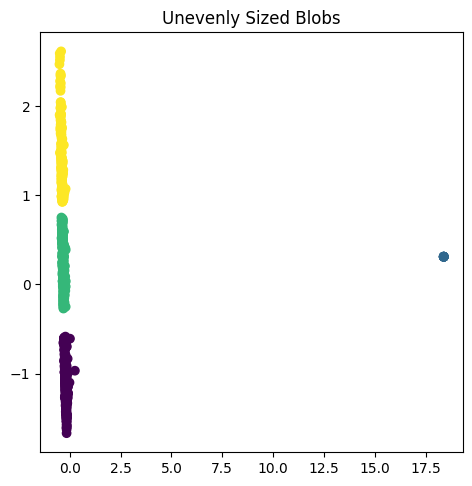

In [57]:
#Настройка параметров
kmeans = KMeans(n_clusters=4, random_state=0).fit(X)
#Предсказание
kmpreds = kmeans.predict(X)
#Заношу кластеризированные метки в набор данных
df["KMCLUSTS"] = kmpreds

#Применяю функцию описаную выше
viz(df["KMCLUSTS"])

#### MiniBatchKMeans

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


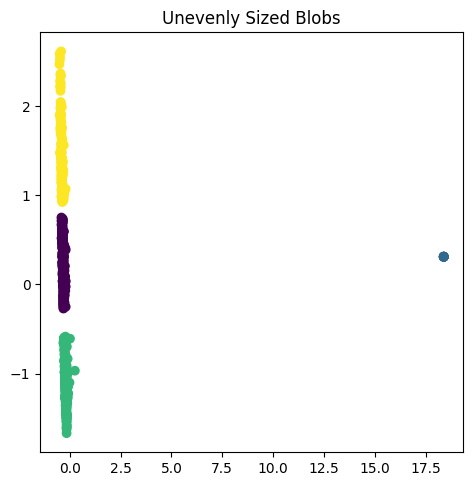

In [58]:
#Настройка параметров
kbmeans = MiniBatchKMeans(n_clusters=4, random_state=0, batch_size=4096)
#Заношу кластеризированные метки в набор данных
df["KBCLUSTS"] = kbmeans.fit_predict(X)

viz(df["KBCLUSTS"])

#### GaussianMixture

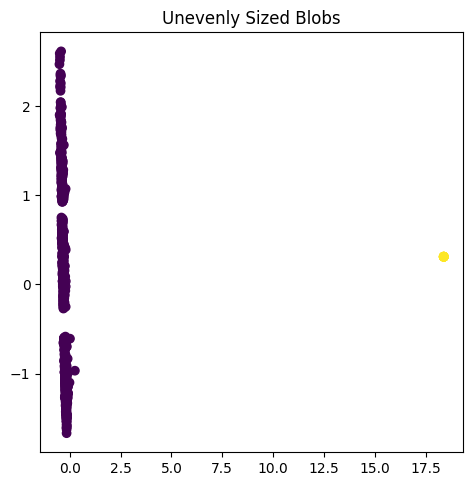

In [59]:
#Настройка параметров
gm = GaussianMixture(n_components=2, random_state=0).fit_predict(X)
#Заношу кластеризированные метки в набор данных
df["GMCLUSTS"] = gm

viz(df["GMCLUSTS"])

#### Результаты метрик

##### Kmeans 

In [60]:
#Использую метрику calinski_harabasz_score
print(sklearn.metrics.calinski_harabasz_score(X, df["KMCLUSTS"]))
#Использую метрику davies_bouldin_score
print(sklearn.metrics.davies_bouldin_score(X, df["KMCLUSTS"]))

14705.750514340967
0.34767290614527013


##### MiniBatchKmeans


In [61]:
#Использую метрику calinski_harabasz_score
print(sklearn.metrics.calinski_harabasz_score(X, df["KBCLUSTS"]))
#Использую метрику davies_bouldin_score
print(sklearn.metrics.davies_bouldin_score(X, df["KBCLUSTS"]))

14705.750514340967
0.34767290614527013


##### GussianMixture

In [62]:
#Использую метрику calinski_harabasz_score
print(sklearn.metrics.calinski_harabasz_score(X, df["GMCLUSTS"]))
#Использую метрику davies_bouldin_score
print(sklearn.metrics.davies_bouldin_score(X, df["GMCLUSTS"]))

3290.9233654780733
0.050201400854763475


#### Решение
По результатам метрик и визуализаций, лучшим алгоритмом является GussianMixture

In [ ]:
# Удаление ненужных атрибутов с кластерами
df.drop(columns=['KMCLUSTS', 'KBCLUSTS'], axis=1, inplace=True)

#Отчет 1 модуля

Тут отчет по пунктам сами напишите...<br>
Нужно указать что было под пунктами:
* 1 - 
* 2 - 
* 3 - 
* 4 -
* И тд...

In [ ]:
# df = pd.read_csv('output.csv')

# 2.1 Разведочный анализ

Построение распределений плотности необходимо построить, чтобы посмотреть какое распределение целевой переменной и других атрибутое
Если распределение плохое (много записей одной категории и мало другой), то можно будет сделать выводы и предположения о точности
определения конкретного класса с помощью модели. Для построения распределений буду использовать барплоты, так как по оси Ох мы сможем
указать нашу нужную переменную, по оси Оу кол-во записей, а цветом будем выделять наши уникальные значения

In [82]:
tk.head()

,Post,day,month,time,Company,rate,subs,industries,about,lemmatize_tokens,clear_text
0,7 декабря состоялась церемония награждения лау...,8,декабря,09:30,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[декабрь, состояться, церемония, награждение, ...",декабрь состояться церемония награждение лауре...
1,"Это — подкаст о контент-маркетинге и о тех, кт...",5,октября,11:23,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[подкаст, контентмаркетинг, писать, редактиров...",подкаст контентмаркетинг писать редактировать ...
2,"Привет, Хабр! Меня зовут Алсу Хлуднева, я — уп...",2,сентября,17:34,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[привет, хабра, звать, алсу, хлуднева, управля...",привет хабра звать алсу хлуднева управлять пар...
3,Алексей Скорик из Vinci Agency специально для ...,4,марта,18:39,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,"[алексей, скорик, специально, блог, нетология,...",алексей скорик специально блог нетология рассп...
4,This post is a continuation of the first part ...,21,января,14:54,data/Vinci Agency,Не указано,Не указано,Не указано,Не указано,[],


In [83]:
df_tfidf.head()

,аббревиатура,абзац,абитуриент,абсолютно,абсолютно весь,абсолютный,абстрагироваться,абстрактный,абстракция,авария,август,авиабилет,авиакомпания,авить,авто,автодополнение,автомат,автоматизатор,автоматизация,автоматизация процесс,автоматизация работа,автоматизация тестирование,автоматизированный,автоматизированный тестирование,автоматизировать,автоматически,автоматический,автоматический режим,автоматический система,автомобиль,автомобильный,автономный,автономный некоммерческий,автопилот,автор,автор книга,автор который,автор курс,автор получить,автор помочь,автор предоставить,автор хороший,автор чтоть,авторизация,авторитет,авторитетный,авторский,авторский канал,авторский право,авторство,автотест,агенство,агент,агентство,агентство который,агентство специализироваться,агентство студия,агентство тасс,агентство туризм,агрегатор,агрегатор такси,агрегация,агрессивный,адаптация,адаптер,адаптивность,адаптивный,адаптивный дизайн,адаптировать,адаптироваться,адекватно,адекватный,адекватный человек,адепт,админ,административный,администратор,администрация,администрирование,админк,адрес,адрес электронный,аести,ажиотаж,азбука,азиатский,азия,айдентик,айсберг,айти,айти курс,айтишник,айфон,академический,академия,аккаунт,аккумулятор,аккуратно,аккуратность,аккуратный,аксессуар,актив,активация,активировать,активироваться,активно,активно использовать,активно использоваться,активно развиваться,активность,активный,активный использование,активный участие,актуально,актуальность,актуальный,актуальный вопрос,актуальный информация,акцент,акцентировать,акцентировать внимание,акционер,акция,акция компания,алгоритм,алгоритм который,алгоритм машинный,алгоритм распознавание,алгоритм структура,алгоритмический,александр,александр рассказать,алексей,алексей копылов,алексей некрасов,алиас,алина,алиса,алкоголь,алфавит,альтернатива,альтернативный,альтернативный вариант,альфа,альфабанк,альфабанка,алёна,амбициозный,амбиция,америка,американец,американский,американский компания,анализ,анализ данные,анализ медицинский,анализ работа,анализ рынок,анализатор,анализировать,анализировать дать,анализироваться,аналитик,аналитик бывать,аналитик данные,аналитик который,аналитика,аналитический,аналог,аналогично,аналогичный,аналогия,анастасия,анатолий,англ,английский,английский язык,англоязычный,андреев,андрей,андроид,анимация,анимация переход,анимировать,анкета,анна,аннотация,аномалия,анонимный,анонс,анонс второй,анонсировать,антенна,антимонопольный,антимонопольный законодательство,антимонопольный служба,антон,антон артёмов,антон носик,апдейт,аппарат,аппаратный,апрель,аргумент,аргумент который,аренда,арендовать,армия,артдиректор,артдиректор дизайнер,артемий,артемий лебедев,артемий лебедеваноминация,артефакт,артур,артём,артём геллер,артёмов,артёмов денис,архив,архипов,архитектор,архитектура,архитектура который,архитектура приложение,архитектурный,асинхронный,аспект,аспирантура,ассет,ассистент,ассортимент,ассоциация,ассоциация профессиональный,ассоциация электронный,ассоциироваться,аська,атака,атаковать,атмосфера,атомный,атрибут,аттестация,аудио,аудит,аудитория,аудитория который,аукцион,аутентификация,аутсорс,аутсорсинг,африка,афтепати,аэропорт,багаж,багаж знание,багрепорт,база,база данные,база знание,база искусственный,база который,базироваться,базовый,базовый вещь,базовый знание,базовый информация,базовый курс,базовый навык,базовый понятие,базовый принцип,базовый уровень,базовый функция,байт,баланс,балансировать,балл,банально,банальный,банк,банк проект,банк россия,банкноминация,банкноминация массовый,банковский,банковский продукт,баннер,баннерный,бардак,барьер,батарея,бауман,башня,бегать,беда,беда войти,бедный,бежать,безграничный,безликий,безопасно,безопасностить,безопасность,безопасный,безразличный,безумие,безумно,безумный,безупречный,безусловно,безусловный,беларусь,белые,белый,бельгия,бельё,бенчмарка,берег,берет,беседа,беседовать,бесконечно,бесконечность,бесконечный,бесконечный количество,беспилотный,беспилотный автомобиль,бесплатно,бесплатноорганизатор,бесплатный,бесплатный вебинар

In [84]:
df=pd.read_json('Target.json')
df = df.rename(columns = {"Company": "Company"})
df.head()

,Company,Nominations
0,Здоровье.ру,Здоровье и медицина
1,Проект по использованию технологий компьютерно...,Здоровье и медицина
2,Skillbox,"Наука, технологии и инновации"
3,Gett,"Наука, технологии и инновации"
4,Промобот,"Наука, технологии и инновации"


In [66]:
df_tfidf["Company"]

0         data/Vinci Agency
1         data/Vinci Agency
2         data/Vinci Agency
3         data/Vinci Agency
4         data/Vinci Agency
               ...         
688       data/Goose Gaming
689    data/ESforce Holding
690    data/ESforce Holding
691    data/ESforce Holding
692    data/ESforce Holding
Name: Company, Length: 693, dtype: object

In [85]:
df_tfidf=df_tfidf.merge(df, on='Сompany')
df_tfidf['Nominations']

KeyError: ignored

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10,4))
sns.histplot(data=df_tfidf,x='Nominations')

# 2.2 Классификация

Так как наша выборка неравномерна, то мы будем использовать метод стратификации, чтобы сохранить записи различных классов, как в
тренировочной, так и в тестовой выборках Обучающих данных у нас немного, поэтому мы будем делить данные так, что 80-05% уйдет на
тренировочную выборку, чтобы модель хорошо обучилась 

4.2 Выбор моделей и метрики
Для задачи классификации данных я выберу следующие 3 модели:
1. Случайный лес (RFC)
2. Деревья решений (DTC)
3. Классификация ближайших соседей (KNN)
Я выбрал эти модели, потому что ВАС умеет хорошо обобщать данные и также делить их, но с помощью множества условий, а ЛТД работает
быстро и его гиперпараметры также быстро подбирается. Также КАС был выбран, так как ВЕС может легко переобучиться и выделять микрокусочек
типерппоскости для каждой записи, в отличии RFC, так как он работает на множестве DTC и методом голосования принимает решение, из-за чего
переобучение труднодостижимо
За метрику я выбрал f1-score (weighted), так как эта метрика показывает насколько сильно модель путается в конкретных классах и как она
различает, в отличии от accuracy, который просто показывает сколько раз модель угадана. Weighted был выбран, так как наша выборка
несбалансирована

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
x=df_tfidf.drop(['Nominations', "Company"], axis=1)
y=df_tfidf['Nominations']

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42, stratify=y)

In [ ]:
from sklearn.tree import DecisionTreeClassifier as Tree


In [ ]:
tree = Tree(max_depth=20, min_samples_split=4, min_samples_leaf=2)

In [ ]:
tree.fit(x_train, y_train)

# Оценка модели

In [ ]:
predictions = tree.predict(x_test)

In [ ]:
from sklearn.metrics import accuracy_score
print(accuracy_score(y_test, predictions))

In [ ]:
df.head()

,AGE,GENDER,EDUCATION_LEVEL,MARITAL_STATUS,INCOME_MAIN_AMT,REG_CODE,INCOME_MAIN_AMT_USD,GMCLUSTS
0,35,2,3,3,87000.0,9.0,1087.5,0
1,34,2,3,3,180000.0,31.0,2250.0,0
2,35,1,1,3,61000.0,38.0,762.5,1
4,39,1,-1,3,34000.0,81.0,425.0,1
5,40,1,1,4,69000.0,81.0,862.5,1


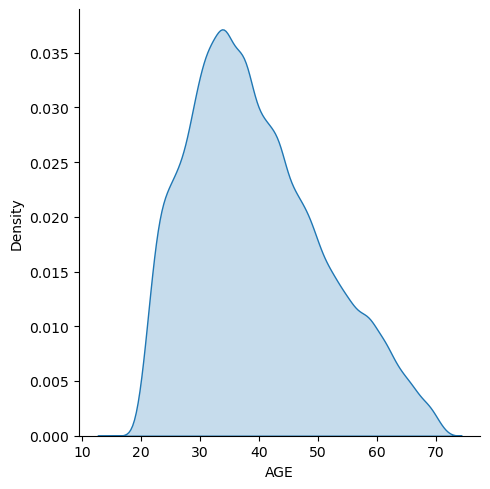

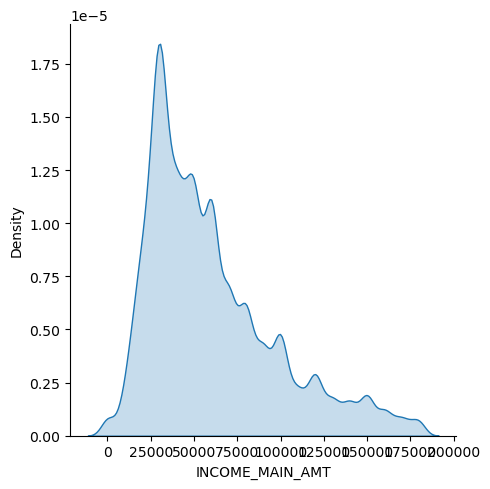

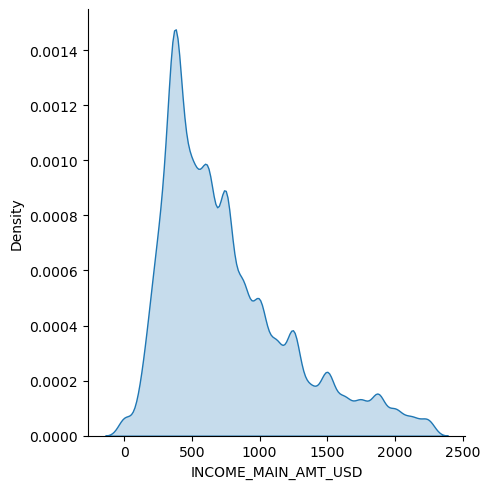

In [ ]:
#Лист с признаками которые не будут учитываться при визуализации (Не категориальные)
skip = ['AGE', 'INCOME_MAIN_AMT', 'INCOME_MAIN_AMT_USD']
#Не категориальные признаки
for i in skip:
    if type(df[i].iloc[2]) == np.int64 or type(df[i].iloc[2]) == np.float64:
        sns.displot(df, x=i, kind="kde", fill=True)

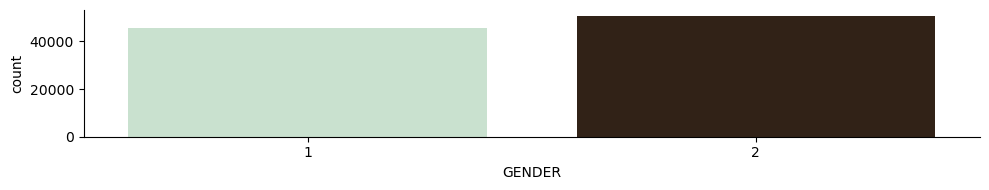

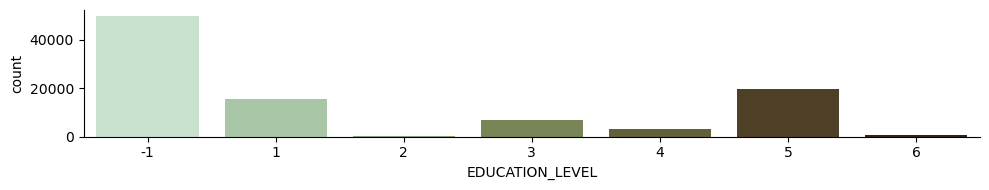

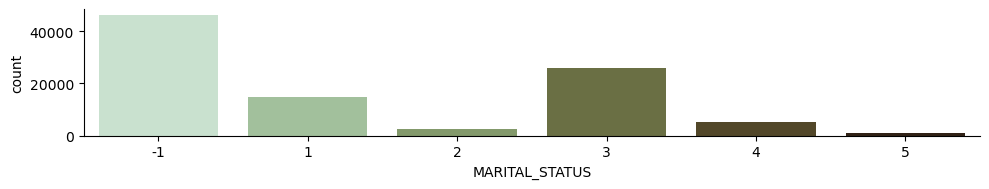

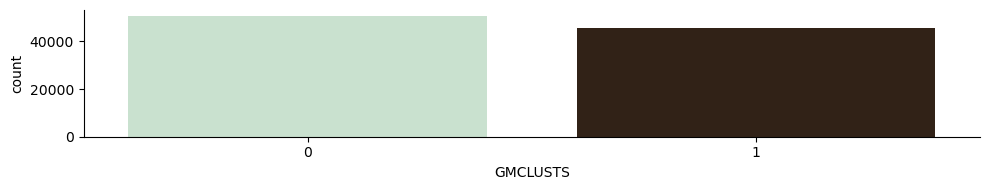

In [ ]:
#Категориальные признаки
for i in df.columns:
    if i not in skip and i != 'REG_CODE':
        sns.catplot(x=i, kind='count', palette='ch:25', height=2, aspect=5, data=df)
        plt.show()

REG_CODE плохо визуализировался, так что его можно вывести отдельно

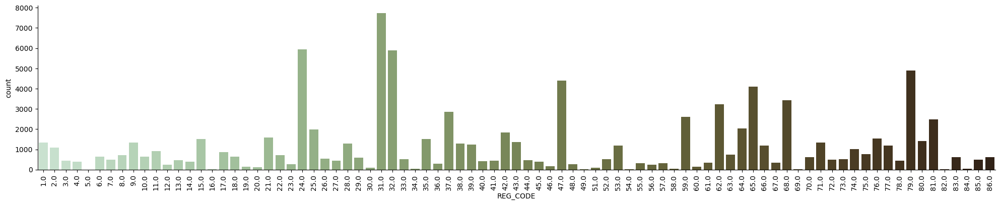

In [ ]:
sns.catplot(x='REG_CODE', kind='count', palette='ch:25', height=4, aspect=5, data=df)
plt.xticks(rotation=90)
plt.show()

### 2.2 Разбиение выборки

In [ ]:
df.head()

,AGE,GENDER,EDUCATION_LEVEL,MARITAL_STATUS,INCOME_MAIN_AMT,REG_CODE,INCOME_MAIN_AMT_USD,GMCLUSTS
0,35,2,3,3,87000.0,9.0,1087.5,0
1,34,2,3,3,180000.0,31.0,2250.0,0
2,35,1,1,3,61000.0,38.0,762.5,1
4,39,1,-1,3,34000.0,81.0,425.0,1
5,40,1,1,4,69000.0,81.0,862.5,1


Система рекомендаций будет определять категорию принадлежности, то есть порекомендовать пользователю товар для мужчин или для женщин

#### MinMaxScaler
Преобразование характеристик путем масштабирования каждой характеристики в заданном диапазоне. Этот оценщик масштабирует и переводит каждый признак в отдельности таким образом,чтобы он находился в заданном диапазоне на обучающем множестве,например,между нулем и единицей.

In [ ]:
#обьявляю MinMaxScaler
scaler = MinMaxScaler()
#преобразую данные
X = scaler.fit_transform(X)

In [ ]:
#Помещу их в переменную X
X = df[["AGE", "EDUCATION_LEVEL", "REG_CODE", "GMCLUSTS"]]
y = df["GENDER"]

In [ ]:
#Разделение данных на обучающий и тестовый набор
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

#### Реализация моделей

#### KNN

In [ ]:
#Объявление классификатор
neigh = KNeighborsClassifier()
#Обучение классификатора
neigh.fit(X_train, y_train)

KNeighborsClassifier()

#### GaussianNB

In [ ]:
#Объявление классификатор
gnb = GaussianNB()
#Обучение классификатора
gnb.fit(X_train, y_train)
GaussianNB()

GaussianNB()

#### LogisticRegression

In [ ]:
#Объявление классификатор
clf = LogisticRegression()
#Обучение классификатора
clf.fit(X_train, y_train)

LogisticRegression()

#### Метрики
Теперь посмотрю на результаты метрик, я буду рассматривать метрики - f1 и accuracy sore, f так же f1 по macro avg

#### KNN

In [ ]:
#Вывожу результаты метрик при помощи classification_report
print(classification_report(y_test, neigh.predict(X_test)))

              precision    recall  f1-score   support

           1       0.98      0.96      0.97     13677
           2       0.97      0.98      0.97     15180

    accuracy                           0.97     28857
   macro avg       0.97      0.97      0.97     28857
weighted avg       0.97      0.97      0.97     28857



#### GaussianNB

In [ ]:
#Вывожу результаты метрик при помощи classification_report
print(classification_report(y_test, gnb.predict(X_test)))

              precision    recall  f1-score   support

           1       1.00      1.00      1.00     13677
           2       1.00      1.00      1.00     15180

    accuracy                           1.00     28857
   macro avg       1.00      1.00      1.00     28857
weighted avg       1.00      1.00      1.00     28857



#### LogisticRegression

In [ ]:
#Вывожу результаты метрик при помощи classification_report
print(classification_report(y_test, clf.predict(X_test)))

              precision    recall  f1-score   support

           1       1.00      1.00      1.00     13677
           2       1.00      1.00      1.00     15180

    accuracy                           1.00     28857
   macro avg       1.00      1.00      1.00     28857
weighted avg       1.00      1.00      1.00     28857



#### Решение
По итогам метрик, остановлюсь на алгоритме KNN, так как он имеет самые высокие показатели, по f1 accuracy показал 0.99, и f1 macro avg 0.99. В то время как остальные алгоритмы показали 1, что может оказаться переобучением.

### 2.3 Оптимизация модели

#### Генерация новых данных

In [ ]:
df.head()

,AGE,GENDER,EDUCATION_LEVEL,MARITAL_STATUS,INCOME_MAIN_AMT,REG_CODE,INCOME_MAIN_AMT_USD,GMCLUSTS
0,35,2,3,3,87000.0,9.0,1087.5,0
1,34,2,3,3,180000.0,31.0,2250.0,0
2,35,1,1,3,61000.0,38.0,762.5,1
4,39,1,-1,3,34000.0,81.0,425.0,1
5,40,1,1,4,69000.0,81.0,862.5,1


В данном случае можно воспользоваться уже созданным нами атрибутом INCOME_MAIN_AMT_USD

In [ ]:
#обьявляю MinMaxScaler
scaler = MinMaxScaler()
#преобразую данные
X = scaler.fit_transform(X)

In [ ]:
#Помещу их в переменную X
X = df[["AGE", "EDUCATION_LEVEL", "REG_CODE", "GMCLUSTS", 'INCOME_MAIN_AMT_USD']]
y = df["GENDER"]

In [ ]:
#Разделение данных на обучающий и тестовый набор
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

#### Реализация моделей

In [ ]:
#Объявление классификатор
neigh2 = KNeighborsClassifier(n_neighbors=2, leaf_size=10, p=3, n_jobs=-1)
#Обучение классификатора
neigh2.fit(X_train, y_train)

KNeighborsClassifier(leaf_size=10, n_jobs=-1, n_neighbors=2, p=3)

#### Метрика

In [ ]:
#Вывожу результаты метрик при помощи classification_report
print(classification_report(y_test, neigh2.predict(X_test)))

              precision    recall  f1-score   support

           1       0.59      0.84      0.69     13677
           2       0.76      0.47      0.58     15180

    accuracy                           0.64     28857
   macro avg       0.68      0.65      0.64     28857
weighted avg       0.68      0.64      0.63     28857



Модель стала хуже, так что для дальнейшего использования лучше будет оставить первую версию

#### Сохранение лучшей модели

Ниже представлен код сохранения модели

In [ ]:
import pickle
filename = 'finalized_model.sav'
pickle.dump(neigh, open(filename, 'wb'))

Так выглядит загрузка модели

In [ ]:
# load the model from disk
#loaded_model = pickle.load(open(filename, 'rb'))

### 2.4 Подготовка отчета

Тут отчет по пунктам сами напишите...<br>
Нужно указать что было под пунктами:
* 1 - 
* 2 - 
* 3 - 
* 4 -
* И тд...

In [ ]:
# df.to_csv('output2.csv', index=False, encoding='utf-8-sig')